# Analysis of cell-to-cell delivery of Cre mRNA in co-culture context

# Introduction

## Imports

In [1]:
import sys
import os
import time
import copy
import random
import math
import itertools

import numpy as np
import scipy
import pandas as pd

# Set pandas display options
pd.set_option('display.max_rows', 30)
pd.set_option('display.max_columns', 100)
pd.set_option('display.width', 1000)

%matplotlib inline
from matplotlib import pyplot as plt
import matplotlib as mpl
import seaborn as sns

# Set plot display options
FONTSIZE = 8  # universal fontsize
params = {
    'font.size': FONTSIZE,
    'axes.titlesize': FONTSIZE,
    'axes.labelsize': FONTSIZE,
    'legend.fontsize': FONTSIZE,
    'xtick.labelsize': FONTSIZE,
    'ytick.labelsize': FONTSIZE,
    'font.family': "Helvetica",
    'pdf.fonttype': 42,
    'ps.fonttype': 42,
    'figure.dpi': 300
   }
mpl.rcParams.update(params)
sns.set_style("ticks", {'axes.grid' : False})

# Set plot output options
output_dir = "outs/imaging_Cre_delivery_coculture"
output_suffix = ""
output_formats = [".png", ".pdf"]

mpl.rc('savefig', dpi=300)

# Define convenience function for saving figures

savefig = True
savefig_args = {"dpi": 300, "bbox_inches": "tight", "pad_inches": 0.1}

def save_figure(fig, name, output_dir=output_dir, output_suffix=output_suffix, output_formats=output_formats, savefig_args=savefig_args):
    if savefig:
        for output_format in output_formats:
            fig.savefig(output_dir + "/" + name + output_suffix + output_format, **savefig_args)
    return None

In [2]:
import skimage.io
from matplotlib_scalebar.scalebar import ScaleBar

In [3]:
# Set random seed to make bootstrapping results predictable
np.random.seed(0)

In [4]:
# Set colors for plots
palette = ["#6b52a2", "#fbb885", "#8a8c8f"]

In [5]:
# Set scale
UM_PER_PX = 0.823449699777044 * 10  # microns per pixel (0.823449699777044 um/px on microscope, multiplied by downscaling factor of 10)

In [6]:
# Set relative intensity of channels in overlay images
INTENSITY_RED_OVERLAY = 10.0
INTENSITY_BLUE_OVERLAY = 0.5

# Analyze delivery with full system

## Load images

In [7]:
infile = "../imaging_data/imaging_Cre_delivery_coculture/full_system/full_system_RFP.tif"
im_r = skimage.io.imread(infile)
im_r = im_r[:,:,0]

infile = "../imaging_data/imaging_Cre_delivery_coculture/full_system/full_system_YFP.tif"
im_g = skimage.io.imread(infile)
im_g = im_g[:,:,1]

infile = "../imaging_data/imaging_Cre_delivery_coculture/full_system/full_system_BFP.tif"
im_b = skimage.io.imread(infile)
im_b = im_b[:,:,2]

im = np.dstack((im_r, im_g, im_b))

print(im.shape)

(25961, 27457, 3)


## Downscale image

In [8]:
im = skimage.transform.downscale_local_mean(im, (10, 10, 1))  # downscale by 10-fold in x and y dimensions
print(im.shape)

(2597, 2746, 3)


## Examine channels

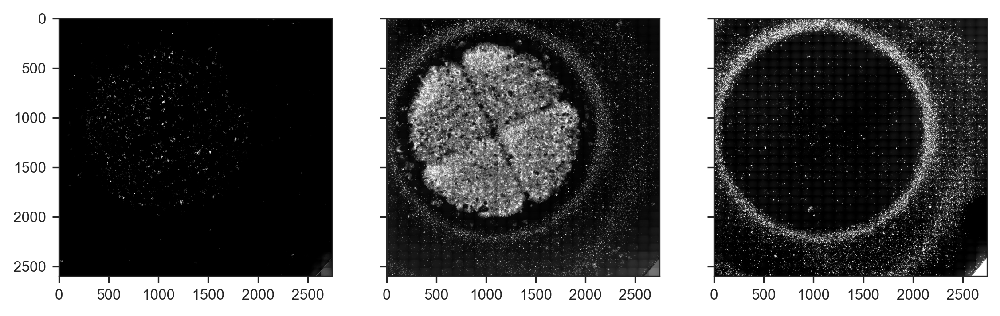

In [9]:
fig, axes = plt.subplots(1, 3, figsize=(9,3), sharey=True)

for i in range(3):
    ax = axes[i]
    ax.imshow(im[:,:,i], cmap=plt.cm.Greys_r)

## Crop to center region of interest

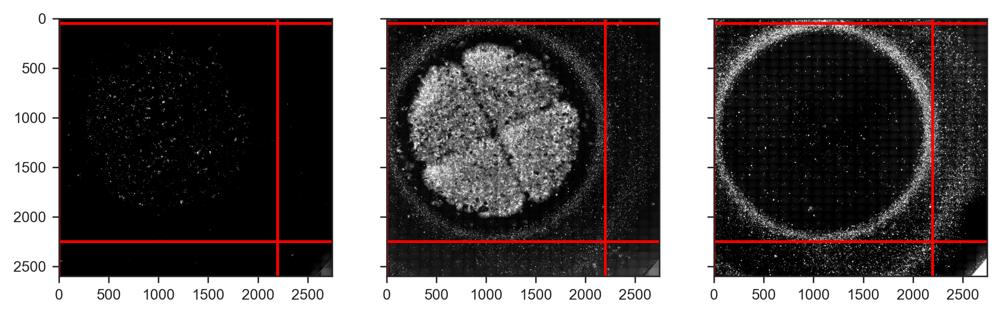

In [10]:
# Find lines for cropping

x_min = 50
x_max = 2250
y_min = 0
y_max = 2200

fig, axes = plt.subplots(1, 3, figsize=(9,3), sharey=True)

for i in range(3):
    ax = axes[i]
    ax.imshow(im[:,:,i], cmap=plt.cm.Greys_r)
    
    ax.axhline(x_min, color="r")
    ax.axhline(x_max, color="r")
    ax.axvline(y_min, color="r")
    ax.axvline(y_max, color="r")

In [11]:
# Crop
im_cropped = im[x_min:x_max, y_min:y_max, :]

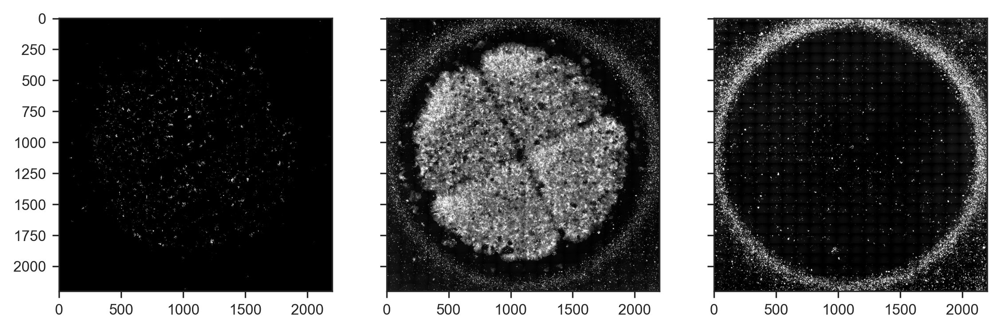

In [12]:
# Examine cropped image
fig, axes = plt.subplots(1, 3, figsize=(9,3), sharey=True)

for i in range(3):
    ax = axes[i]
    ax.imshow(im_cropped[:,:,i], cmap=plt.cm.Greys_r)

## Plot montage with color

Text(0.5, 1.0, 'BFP')

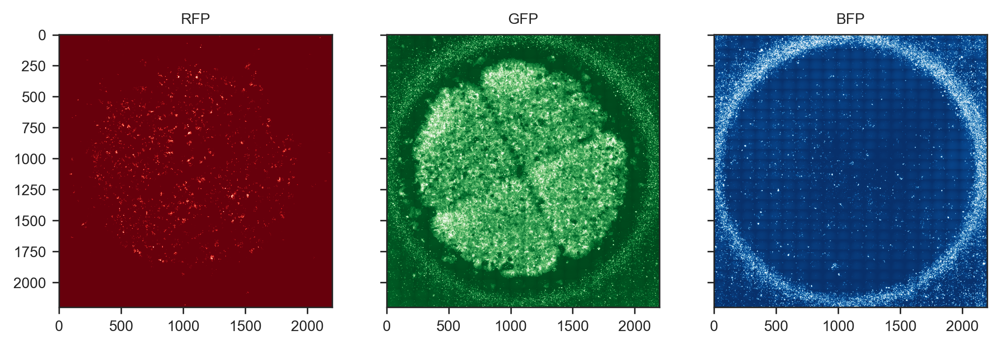

In [13]:
# Examine cropped image
fig, axes = plt.subplots(1, 3, figsize=(9,3), sharey=True)

ax = axes[0]
ax.imshow(im_cropped[:,:,0], cmap=plt.cm.Reds_r)
ax.set_title("RFP")

ax = axes[1]
ax.imshow(im_cropped[:,:,1], cmap=plt.cm.Greens_r)
ax.set_title("GFP")

ax = axes[2]
ax.imshow(im_cropped[:,:,2], cmap=plt.cm.Blues_r)
ax.set_title("BFP")

## Plot overlay

In [14]:
# Create overlay

im_overlay = im_cropped.copy()

im_overlay[:,:,1] = 0  # set green channel to zero

im_overlay[:,:,0] = im_overlay[:,:,0] * INTENSITY_RED_OVERLAY  # scale intensity of red channel
im_overlay[:,:,2] = im_overlay[:,:,2] * INTENSITY_BLUE_OVERLAY  # scale intensity of blue channel

im_overlay = im_overlay / 80  # rescale intensities to range [0, 1]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


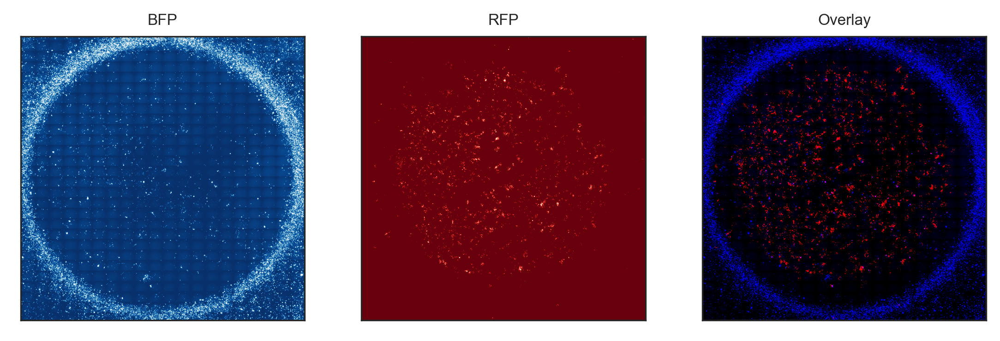

In [15]:
# Examine overlay

fig, axes = plt.subplots(1, 3, figsize=(9,3), sharey=True)

ax = axes[0]
ax.imshow(im_cropped[:,:,2], cmap=plt.cm.Blues_r)
ax.set_title("BFP")

ax = axes[1]
ax.imshow(im_cropped[:,:,0], cmap=plt.cm.Reds_r)
ax.set_title("RFP")

ax = axes[2]
ax.imshow(im_overlay)
ax.set_title("Overlay")

for ax in axes:
    ax.set_xticks([])
    ax.set_yticks([])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


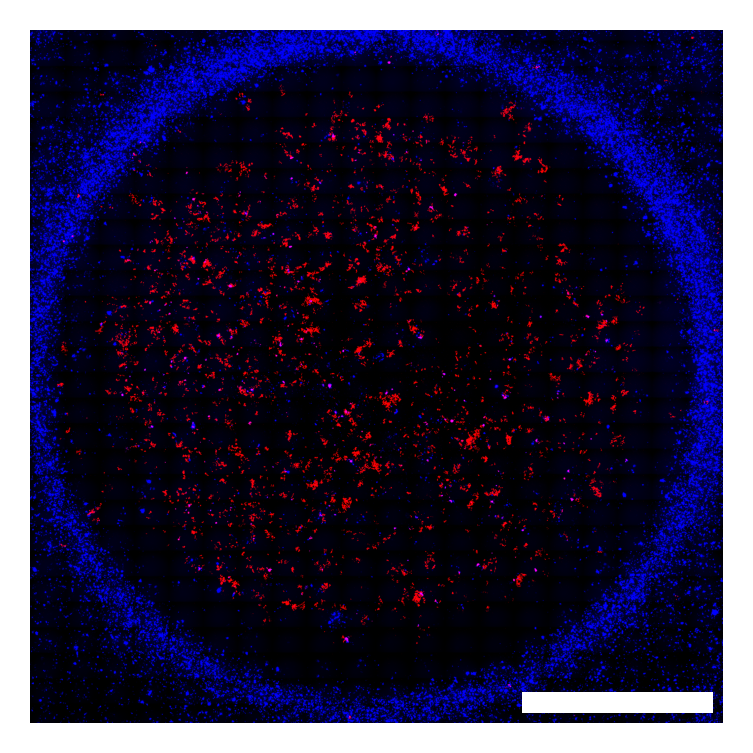

In [16]:
fig, ax = plt.subplots(1, 1, figsize=(3,3))

ax.imshow(im_overlay)

ax.set_xticks([])
ax.set_yticks([])
ax.axis('off')

scalebar = ScaleBar(UM_PER_PX, "um",
                    fixed_value=5000,
                    width_fraction=0.03,
                    location="lower right",
                    scale_loc="none",
                    color="#ffffff",
                    frameon=False)
ax.add_artist(scalebar)

save_figure(fig, "im_FullSystem_Overlay")

## Calculate intensity as a function of distance

### Set reference point

In [17]:
# Set reference point
x_0 = 1100
y_0 = 1050

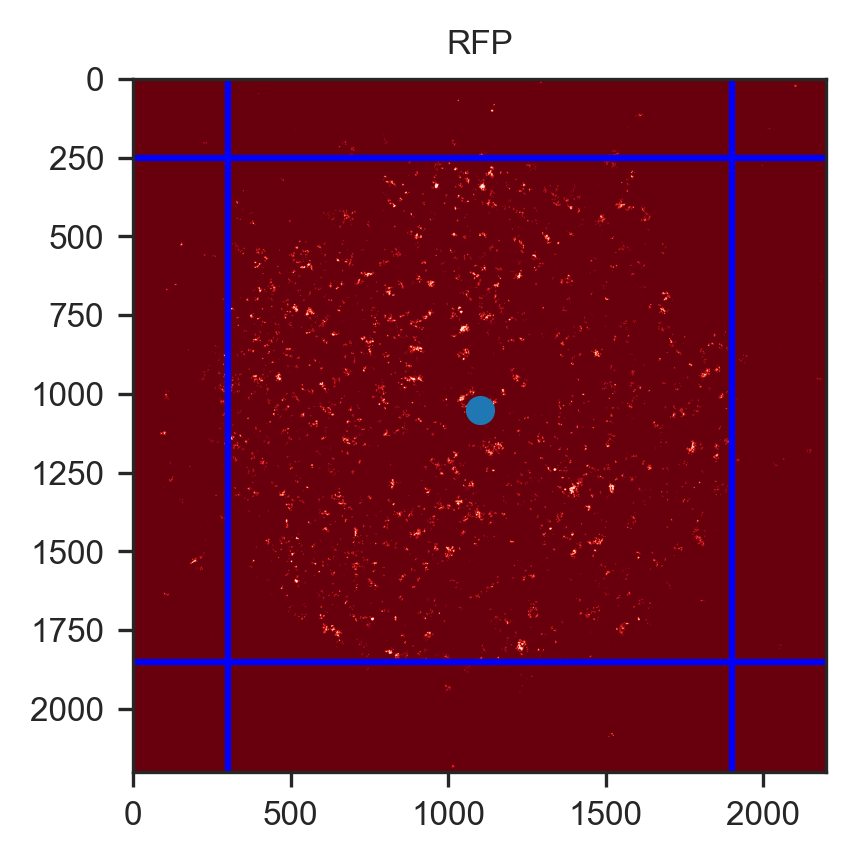

In [18]:
# Plot reference point

fig, ax = plt.subplots(1, 1, figsize=(3,3))

ax.imshow(im_cropped[:,:,0], cmap=plt.cm.Reds_r)
ax.set_title("RFP")

ax.scatter(x_0, y_0)

w = 800
h = 800
ax.axvline(x_0 - w, c="b")
ax.axvline(x_0 + w, c="b")
ax.axhline(y_0 - h, c="b")
ax.axhline(y_0 + h, c="b")

### Calculate distance to reference point

In [19]:
# Calculate distance to a reference point
def euclidean_distance_to_reference(x, y, x_0, y_0):
    d = np.sqrt( (x - x_0)**2 + (y - y_0)**2 )
    return d

In [20]:
# Calculate distance from each point to reference point

distance_to_reference = np.full_like(im_cropped, np.nan)[:,:,0]  # initialize an array with the same x-y shape as image

for x in range(distance_to_reference.shape[0]):
    for y in range(distance_to_reference.shape[1]):
        d = euclidean_distance_to_reference(x, y, x_0, y_0)
        distance_to_reference[x, y] = d

### Calculate intensity within shells

In [21]:
%%time

# Run for all shells

n_rep = 10  # number of bootstrap replicates

# Define shells of distance from reference point
shells = [(0, 100),
          (100, 200),
          (200, 300),
          (300, 400),
          (400, 500),
          (500, 600),
          (600, 700),
          (700, 800),
          (800, 900),
          (900, 1000),
          (1000, 1100),
          (1100, 1200),
          (1200, 1300),
          (1300, 1400)]

df = pd.DataFrame(index=range(len(shells)))

df["r_min"] = np.nan
df["r_max"] = np.nan
df["r_mean"] = np.nan
df["intensity_mean"] = np.nan
df["intensity_std"] = np.nan
df["intensity_sum"] = np.nan

for i, shell in enumerate(shells):
    
    d_0, d_1 = shell

    mask = (distance_to_reference < d_1) & (distance_to_reference > d_0)

    im_masked = im_cropped.copy()
    im_masked = im_masked[:,:,0]
    im_masked[~mask] = np.nan

    mu = np.nanmean(im_masked)
    std = np.nanstd(im_masked)
    
    # Calculate bootstrap confidence interval by sampling pixels

    samples_mean = []

    for _ in range(n_rep):
        m = np.mean(np.random.choice(im_masked[mask], size=im_masked[mask].shape[0]))
        samples_mean.append(m)

    mu_bootstrap = np.mean(np.array(samples_mean))
    std_bootstrap = np.std(np.array(samples_mean))

    df.loc[i, "r_min"] = d_0
    df.loc[i, "r_max"] = d_1
    df.loc[i, "r_mean"] = (d_0 + d_1) / 2
    df.loc[i, "intensity_mean"] = mu
    df.loc[i, "intensity_std"] = std
    df.loc[i, "intensity_bootstrap_mean"] = mu_bootstrap
    df.loc[i, "intensity_bootstrap_std"] = std_bootstrap


CPU times: user 3.47 s, sys: 663 ms, total: 4.14 s
Wall time: 4.14 s


In [22]:
# Calculate distance to senders
df["d_sender_mean"] = 950 - df["r_mean"]
df["d_sender_mean_um"] = df["d_sender_mean"] * UM_PER_PX
df["d_sender_mean_mm"] = df["d_sender_mean_um"] / 1000

### Write values into dataframe for all samples

In [23]:
df["Condition"] = "FullSystem"

df_all = pd.concat([df])

df_all

,r_min,r_max,r_mean,intensity_mean,intensity_std,intensity_sum,intensity_bootstrap_mean,intensity_bootstrap_std,d_sender_mean,d_sender_mean_um,d_sender_mean_mm,Condition
0,0.0,100.0,50.0,3.275923,21.619910,NaN,3.242397,0.069747,900.0,7411.047298,7.411047,FullSystem
1,100.0,200.0,150.0,3.283990,20.878450,NaN,3.259846,0.058987,800.0,6587.597598,6.587598,FullSystem
2,200.0,300.0,250.0,3.776230,22.551082,NaN,3.755832,0.038625,700.0,5764.147898,5.764148,FullSystem
3,300.0,400.0,350.0,3.714148,22.770985,NaN,3.702812,0.040534,600.0,4940.698199,4.940698,FullSystem
4,400.0,500.0,450.0,3.335142,20.818657,NaN,3.331291,0.033497,500.0,4117.248499,4.117248,FullSystem
5,500.0,600.0,550.0,2.501839,17.653983,NaN,2.491647,0.030900,400.0,3293.798799,3.293799,FullSystem
6,600.0,700.0,650.0,2.434703,17.919099,NaN,2.419030,0.027850,300.0,2470.349099,2.470349,FullSystem
7,700.0,800.0,750.0,3.046548,19.942891,NaN,3.044321,0.023751,200.0,1646.899400,1.646899,FullSystem
8,800.0,900.0,850.0,0.926615,10.303888,NaN,0.930117,0.010600,100.0,823.449700,0.823450,FullSystem
9,900.0,1000.0,950.0,0.269875,5.436763,NaN,0.269492,0.005987,0.0,0.000000,0.000000,FullSystem


In [24]:
# HERE

# Analyze delivery for negative control (lacking exporter)

## Load images

In [25]:
infile = "../imaging_data/imaging_Cre_delivery_coculture/no_exporter/no_exporter_RFP.tif"
im_r = skimage.io.imread(infile)
im_r = im_r[:,:,0]

infile = "../imaging_data/imaging_Cre_delivery_coculture/no_exporter/no_exporter_YFP.tif"
im_g = skimage.io.imread(infile)
im_g = im_g[:,:,1]

infile = "../imaging_data/imaging_Cre_delivery_coculture/no_exporter/no_exporter_BFP.tif"
im_b = skimage.io.imread(infile)
im_b = im_b[:,:,2]

im = np.dstack((im_r, im_g, im_b))

print(im.shape)

(25956, 27462, 3)


## Downscale image

In [26]:
im = skimage.transform.downscale_local_mean(im, (10, 10, 1))  # downscale by 10-fold in x and y dimensions
print(im.shape)

(2596, 2747, 3)


## Examine channels

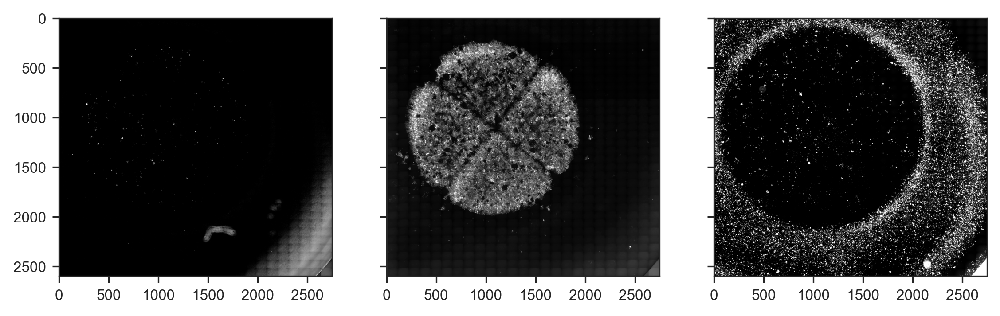

In [27]:
fig, axes = plt.subplots(1, 3, figsize=(9,3), sharey=True)

for i in range(3):
    ax = axes[i]
    ax.imshow(im[:,:,i], cmap=plt.cm.Greys_r)

## Crop to center region of interest

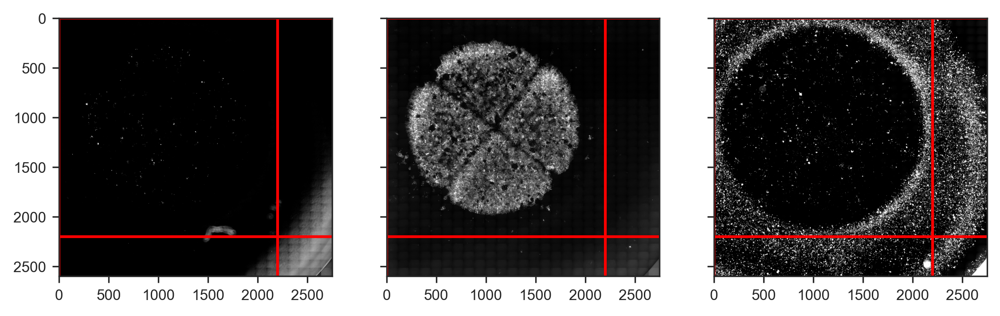

In [28]:
# Find lines for cropping

x_min = 0
x_max = 2200
y_min = 0
y_max = 2200

fig, axes = plt.subplots(1, 3, figsize=(9,3), sharey=True)

for i in range(3):
    ax = axes[i]
    ax.imshow(im[:,:,i], cmap=plt.cm.Greys_r)
    
    ax.axhline(x_min, color="r")
    ax.axhline(x_max, color="r")
    ax.axvline(y_min, color="r")
    ax.axvline(y_max, color="r")

In [29]:
# Crop
im_cropped = im[x_min:x_max, y_min:y_max, :]

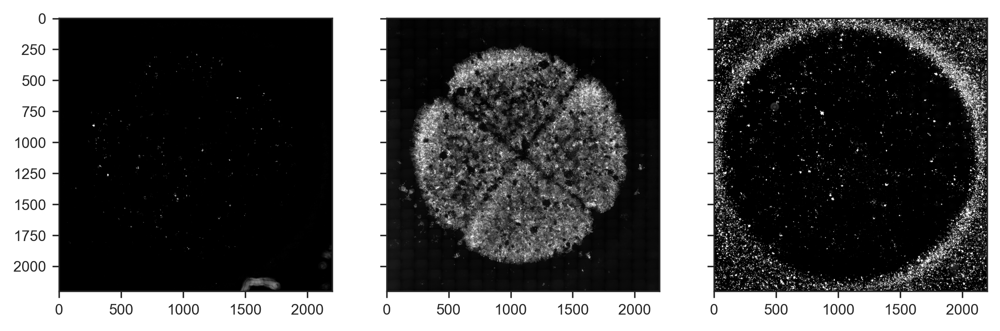

In [30]:
# Examine cropped image
fig, axes = plt.subplots(1, 3, figsize=(9,3), sharey=True)

for i in range(3):
    ax = axes[i]
    ax.imshow(im_cropped[:,:,i], cmap=plt.cm.Greys_r)

## Plot montage with color

Text(0.5, 1.0, 'BFP')

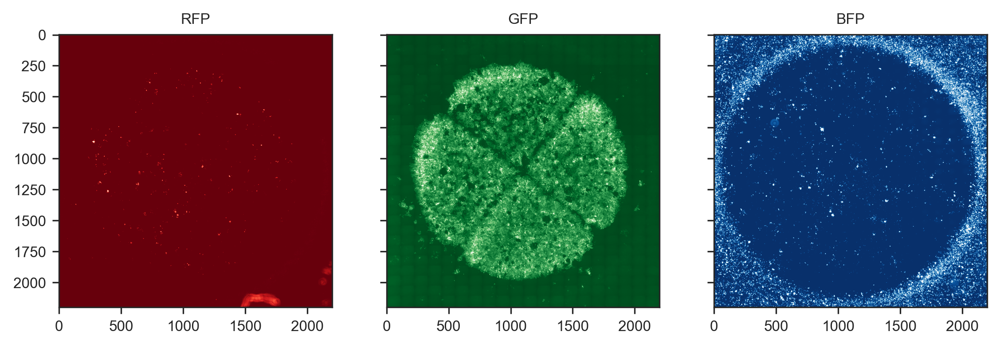

In [31]:
# Examine cropped image
fig, axes = plt.subplots(1, 3, figsize=(9,3), sharey=True)

ax = axes[0]
ax.imshow(im_cropped[:,:,0], cmap=plt.cm.Reds_r)
ax.set_title("RFP")

ax = axes[1]
ax.imshow(im_cropped[:,:,1], cmap=plt.cm.Greens_r)
ax.set_title("GFP")

ax = axes[2]
ax.imshow(im_cropped[:,:,2], cmap=plt.cm.Blues_r)
ax.set_title("BFP")

## Plot overlay

In [32]:
# Create overlay

im_overlay = im_cropped.copy()

im_overlay[:,:,1] = 0  # set green channel to zero

im_overlay[:,:,0] = im_overlay[:,:,0] * INTENSITY_RED_OVERLAY  # scale intensity of red channel
im_overlay[:,:,2] = im_overlay[:,:,2] * INTENSITY_BLUE_OVERLAY  # scale intensity of blue channel

im_overlay = im_overlay / 80  # rescale intensities to range [0, 1]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


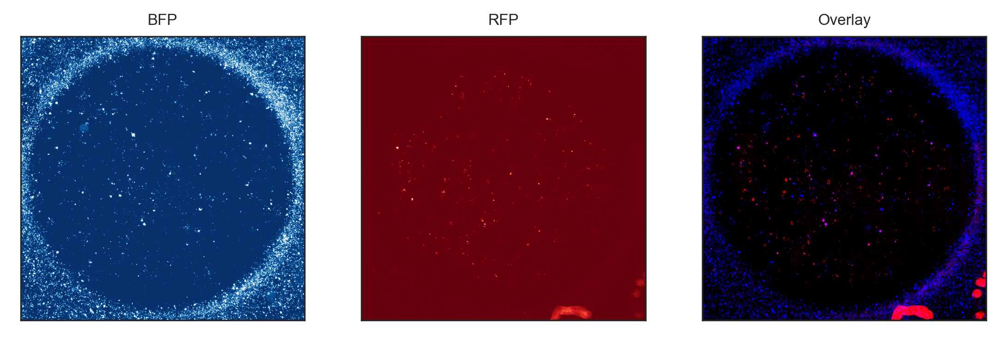

In [33]:
# Examine overlay

fig, axes = plt.subplots(1, 3, figsize=(9,3), sharey=True)

ax = axes[0]
ax.imshow(im_cropped[:,:,2], cmap=plt.cm.Blues_r)
ax.set_title("BFP")

ax = axes[1]
ax.imshow(im_cropped[:,:,0], cmap=plt.cm.Reds_r)
ax.set_title("RFP")

ax = axes[2]
ax.imshow(im_overlay)
ax.set_title("Overlay")

for ax in axes:
    ax.set_xticks([])
    ax.set_yticks([])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


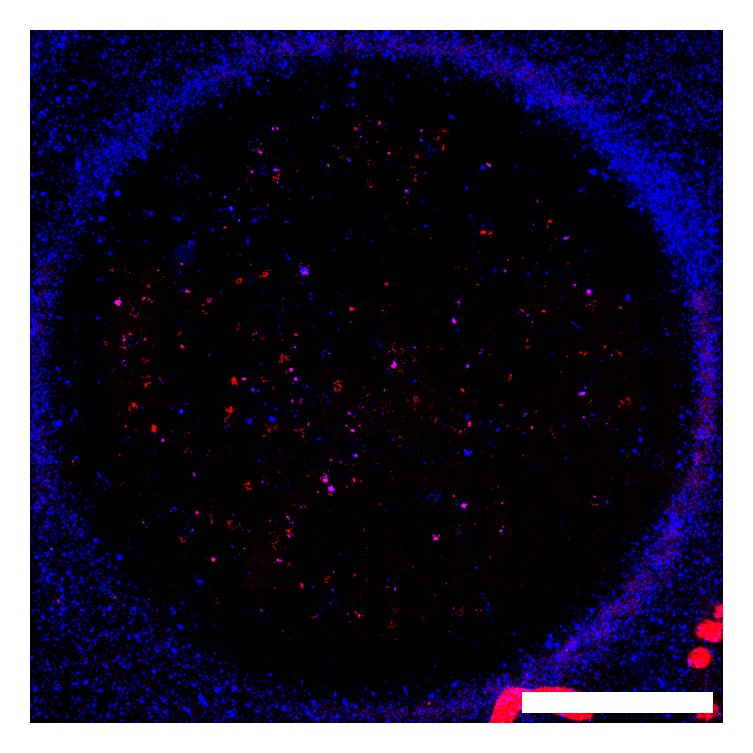

In [34]:
fig, ax = plt.subplots(1, 1, figsize=(3,3))

ax.imshow(im_overlay)

ax.set_xticks([])
ax.set_yticks([])
ax.axis('off')

scalebar = ScaleBar(UM_PER_PX, "um",
                    fixed_value=5000,
                    width_fraction=0.03,
                    location="lower right",
                    scale_loc="none",
                    color="#ffffff",
                    frameon=False)
ax.add_artist(scalebar)

save_figure(fig, "im_NoExporter_Overlay")

## Calculate intensity as a function of distance

### Set reference point

In [35]:
# Set reference point
x_0 = 1100
y_0 = 1050

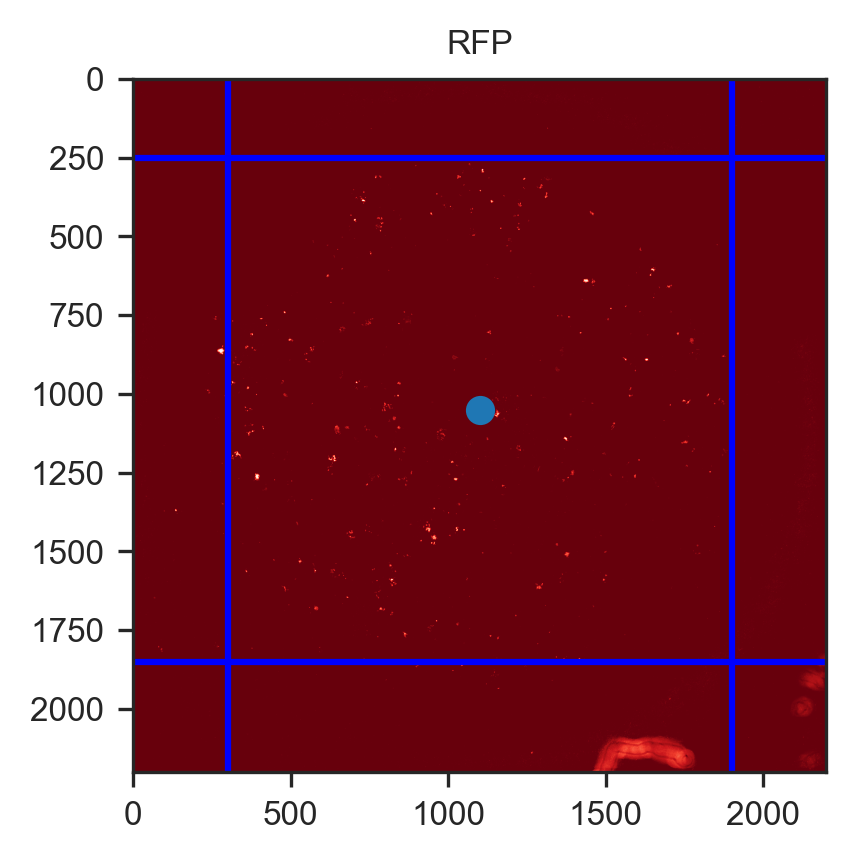

In [36]:
# Plot reference point

fig, ax = plt.subplots(1, 1, figsize=(3,3))

ax.imshow(im_cropped[:,:,0], cmap=plt.cm.Reds_r)
ax.set_title("RFP")

ax.scatter(x_0, y_0)

w = 800
h = 800
ax.axvline(x_0 - w, c="b")
ax.axvline(x_0 + w, c="b")
ax.axhline(y_0 - h, c="b")
ax.axhline(y_0 + h, c="b")

### Calculate distance to reference point

In [37]:
%%time

distance_to_reference = np.full_like(im_cropped, np.nan)[:,:,0]  # initialize an array with the same x-y shape as image

for x in range(distance_to_reference.shape[0]):
    for y in range(distance_to_reference.shape[1]):
        d = euclidean_distance_to_reference(x, y, x_0, y_0)
        distance_to_reference[x, y] = d

CPU times: user 16.2 s, sys: 27.9 ms, total: 16.2 s
Wall time: 16.2 s


In [38]:
%%time

# Run for all shells

n_rep = 10  # number of bootstrap replicates

# Define shells of distance from reference point
shells = [(0, 100),
          (100, 200),
          (200, 300),
          (300, 400),
          (400, 500),
          (500, 600),
          (600, 700),
          (700, 800),
          (800, 900),
          (900, 1000),
          (1000, 1100),
          (1100, 1200),
          (1200, 1300),
          (1300, 1400)]

df = pd.DataFrame(index=range(len(shells)))

df["r_min"] = np.nan
df["r_max"] = np.nan
df["r_mean"] = np.nan
df["intensity_mean"] = np.nan
df["intensity_std"] = np.nan
df["intensity_sum"] = np.nan

for i, shell in enumerate(shells):
    
    d_0, d_1 = shell

    mask = (distance_to_reference < d_1) & (distance_to_reference > d_0)

    im_masked = im_cropped.copy()
    im_masked = im_masked[:,:,0]
    im_masked[~mask] = np.nan

    mu = np.nanmean(im_masked)
    std = np.nanstd(im_masked)
    
    # Calculate bootstrap confidence interval by sampling pixels

    samples_mean = []

    for _ in range(n_rep):
        m = np.mean(np.random.choice(im_masked[mask], size=im_masked[mask].shape[0]))
        samples_mean.append(m)

    mu_bootstrap = np.mean(np.array(samples_mean))
    std_bootstrap = np.std(np.array(samples_mean))

    df.loc[i, "r_min"] = d_0
    df.loc[i, "r_max"] = d_1
    df.loc[i, "r_mean"] = (d_0 + d_1) / 2
    df.loc[i, "intensity_mean"] = mu
    df.loc[i, "intensity_std"] = std
    df.loc[i, "intensity_bootstrap_mean"] = mu_bootstrap
    df.loc[i, "intensity_bootstrap_std"] = std_bootstrap


CPU times: user 3.6 s, sys: 604 ms, total: 4.2 s
Wall time: 4.2 s


In [39]:
# Calculate distance to senders
df["d_sender_mean"] = 950 - df["r_mean"]
df["d_sender_mean_um"] = df["d_sender_mean"] * UM_PER_PX
df["d_sender_mean_mm"] = df["d_sender_mean_um"] / 1000

### Write values into dataframe for all samples

In [40]:
df["Condition"] = "NoExporter"

df_all = pd.concat([df_all, df])

df_all

,r_min,r_max,r_mean,intensity_mean,intensity_std,intensity_sum,intensity_bootstrap_mean,intensity_bootstrap_std,d_sender_mean,d_sender_mean_um,d_sender_mean_mm,Condition
0,0.0,100.0,50.0,3.275923,21.619910,NaN,3.242397,0.069747,900.0,7411.047298,7.411047,FullSystem
1,100.0,200.0,150.0,3.283990,20.878450,NaN,3.259846,0.058987,800.0,6587.597598,6.587598,FullSystem
2,200.0,300.0,250.0,3.776230,22.551082,NaN,3.755832,0.038625,700.0,5764.147898,5.764148,FullSystem
3,300.0,400.0,350.0,3.714148,22.770985,NaN,3.702812,0.040534,600.0,4940.698199,4.940698,FullSystem
4,400.0,500.0,450.0,3.335142,20.818657,NaN,3.331291,0.033497,500.0,4117.248499,4.117248,FullSystem
5,500.0,600.0,550.0,2.501839,17.653983,NaN,2.491647,0.030900,400.0,3293.798799,3.293799,FullSystem
6,600.0,700.0,650.0,2.434703,17.919099,NaN,2.419030,0.027850,300.0,2470.349099,2.470349,FullSystem
7,700.0,800.0,750.0,3.046548,19.942891,NaN,3.044321,0.023751,200.0,1646.899400,1.646899,FullSystem
8,800.0,900.0,850.0,0.926615,10.303888,NaN,0.930117,0.010600,100.0,823.449700,0.823450,FullSystem
9,900.0,1000.0,950.0,0.269875,5.436763,NaN,0.269492,0.005987,0.0,0.000000,0.000000,FullSystem


# Analyze delivery for negative control (lacking exporter and fusogen)

## Load images

In [41]:
infile = "../imaging_data/imaging_Cre_delivery_coculture/no_exporter_no_fusogen/no_exporter_no_fusogen_RFP.tif"
im_r = skimage.io.imread(infile)
im_r = im_r[:,:,0]

infile = "../imaging_data/imaging_Cre_delivery_coculture/no_exporter_no_fusogen/no_exporter_no_fusogen_YFP.tif"
im_g = skimage.io.imread(infile)
im_g = im_g[:,:,1]

infile = "../imaging_data/imaging_Cre_delivery_coculture/no_exporter_no_fusogen/no_exporter_no_fusogen_BFP.tif"
im_b = skimage.io.imread(infile)
im_b = im_b[:,:,2]

im = np.dstack((im_r, im_g, im_b))

print(im.shape)

(25956, 27461, 3)


## Downscale image

In [42]:
im = skimage.transform.downscale_local_mean(im, (10, 10, 1))  # downscale by 10-fold in x and y dimensions
print(im.shape)

(2596, 2747, 3)


## Examine channels

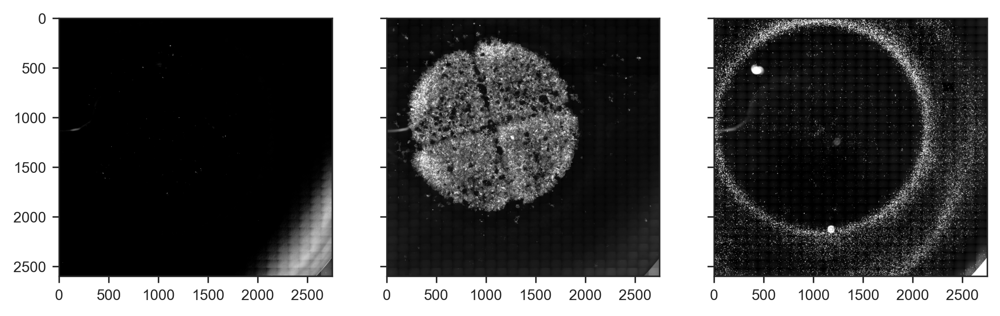

In [43]:
fig, axes = plt.subplots(1, 3, figsize=(9,3), sharey=True)

for i in range(3):
    ax = axes[i]
    ax.imshow(im[:,:,i], cmap=plt.cm.Greys_r)

## Crop to center region of interest

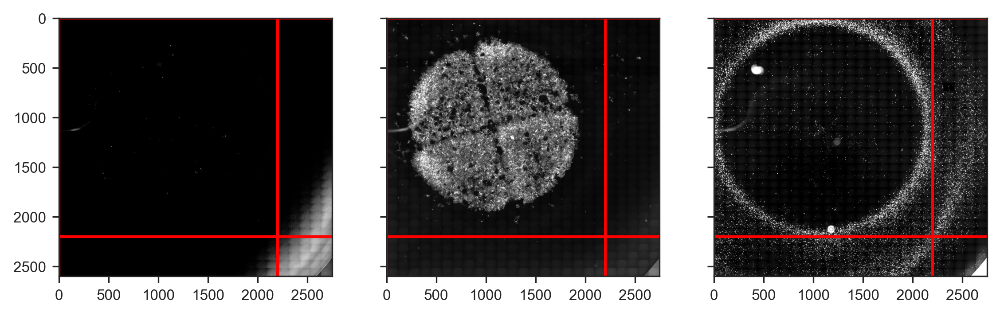

In [44]:
# Find lines for cropping

x_min = 0
x_max = 2200
y_min = 0
y_max = 2200

fig, axes = plt.subplots(1, 3, figsize=(9,3), sharey=True)

for i in range(3):
    ax = axes[i]
    ax.imshow(im[:,:,i], cmap=plt.cm.Greys_r)
    
    ax.axhline(x_min, color="r")
    ax.axhline(x_max, color="r")
    ax.axvline(y_min, color="r")
    ax.axvline(y_max, color="r")

In [45]:
# Crop
im_cropped = im[x_min:x_max, y_min:y_max, :]

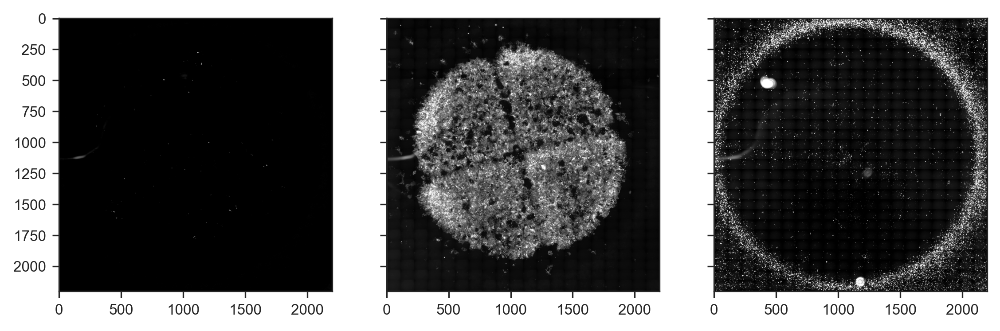

In [46]:
# Examine cropped image
fig, axes = plt.subplots(1, 3, figsize=(9,3), sharey=True)

for i in range(3):
    ax = axes[i]
    ax.imshow(im_cropped[:,:,i], cmap=plt.cm.Greys_r)

## Plot montage with color

Text(0.5, 1.0, 'BFP')

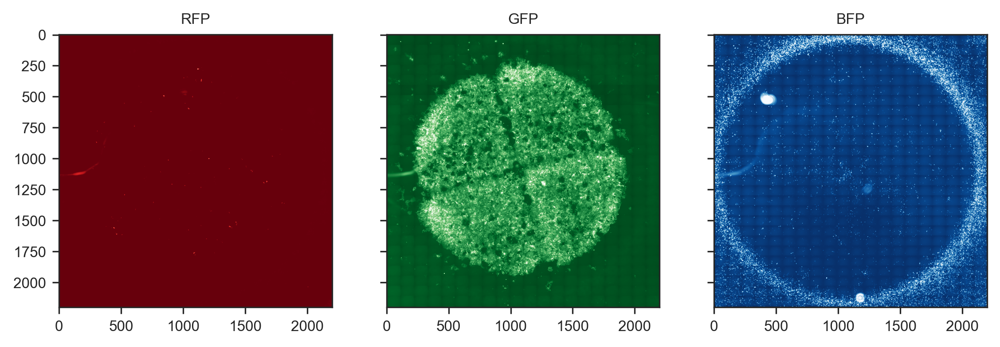

In [47]:
# Examine cropped image
fig, axes = plt.subplots(1, 3, figsize=(9,3), sharey=True)

ax = axes[0]
ax.imshow(im_cropped[:,:,0], cmap=plt.cm.Reds_r)
ax.set_title("RFP")

ax = axes[1]
ax.imshow(im_cropped[:,:,1], cmap=plt.cm.Greens_r)
ax.set_title("GFP")

ax = axes[2]
ax.imshow(im_cropped[:,:,2], cmap=plt.cm.Blues_r)
ax.set_title("BFP")

## Plot overlay

In [48]:
# Create overlay

im_overlay = im_cropped.copy()

im_overlay[:,:,1] = 0  # set green channel to zero

im_overlay[:,:,0] = im_overlay[:,:,0] * INTENSITY_RED_OVERLAY  # scale intensity of red channel
im_overlay[:,:,2] = im_overlay[:,:,2] * INTENSITY_BLUE_OVERLAY  # scale intensity of blue channel

im_overlay = im_overlay / 80  # rescale intensities to range [0, 1]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


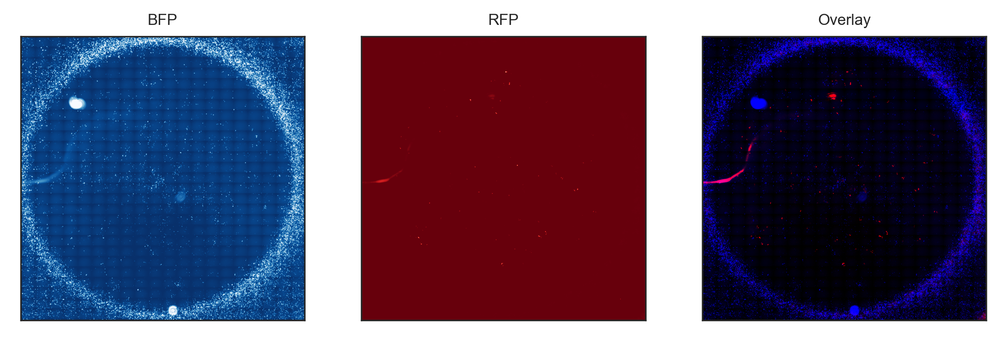

In [49]:
# Examine overlay

fig, axes = plt.subplots(1, 3, figsize=(9,3), sharey=True)

ax = axes[0]
ax.imshow(im_cropped[:,:,2], cmap=plt.cm.Blues_r)
ax.set_title("BFP")

ax = axes[1]
ax.imshow(im_cropped[:,:,0], cmap=plt.cm.Reds_r)
ax.set_title("RFP")

ax = axes[2]
ax.imshow(im_overlay)
ax.set_title("Overlay")

for ax in axes:
    ax.set_xticks([])
    ax.set_yticks([])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


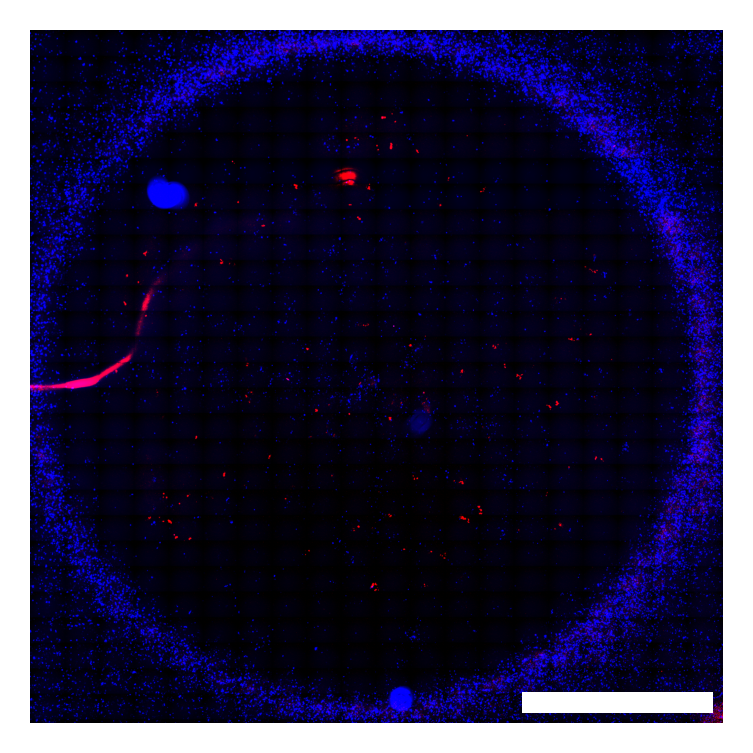

In [50]:
fig, ax = plt.subplots(1, 1, figsize=(3,3))

ax.imshow(im_overlay)

ax.set_xticks([])
ax.set_yticks([])
ax.axis('off')

scalebar = ScaleBar(UM_PER_PX, "um",
                    fixed_value=5000,
                    width_fraction=0.03,
                    location="lower right",
                    scale_loc="none",
                    color="#ffffff",
                    frameon=False)
ax.add_artist(scalebar)

save_figure(fig, "im_NoExporterNoFusogen_Overlay")

## Calculate intensity as a function of distance

### Set reference point

In [51]:
# Set reference point
x_0 = 1100
y_0 = 1050

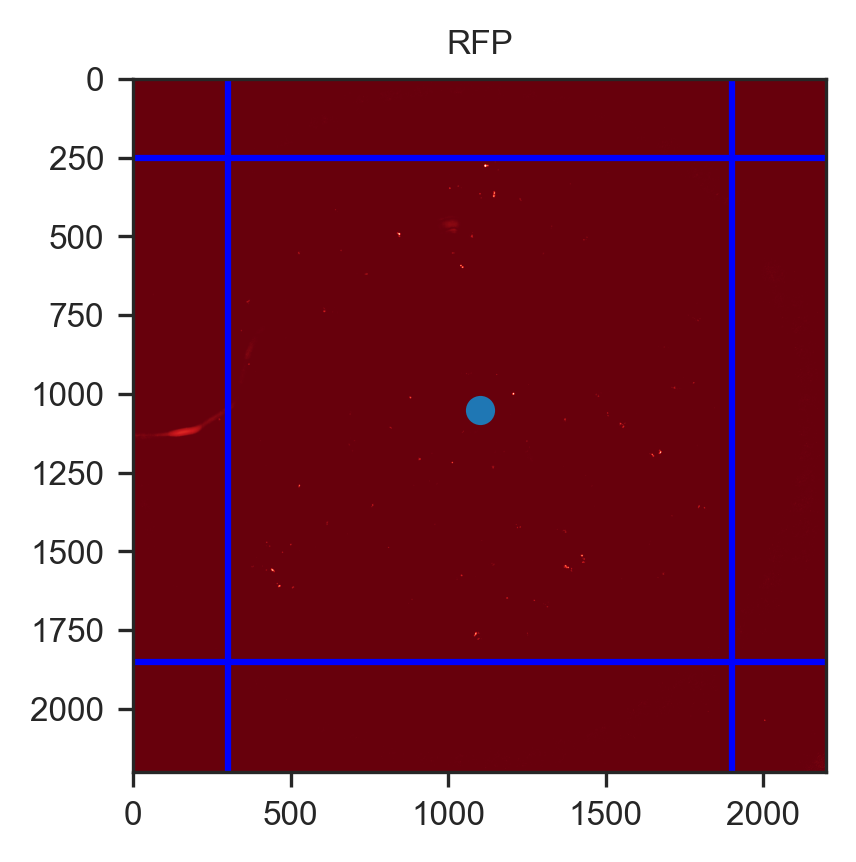

In [52]:
# Plot reference point

fig, ax = plt.subplots(1, 1, figsize=(3,3))

ax.imshow(im_cropped[:,:,0], cmap=plt.cm.Reds_r)
ax.set_title("RFP")

ax.scatter(x_0, y_0)

w = 800
h = 800
ax.axvline(x_0 - w, c="b")
ax.axvline(x_0 + w, c="b")
ax.axhline(y_0 - h, c="b")
ax.axhline(y_0 + h, c="b")

### Calculate distance to reference point

In [53]:
%%time

distance_to_reference = np.full_like(im_cropped, np.nan)[:,:,0]  # initialize an array with the same x-y shape as image

for x in range(distance_to_reference.shape[0]):
    for y in range(distance_to_reference.shape[1]):
        d = euclidean_distance_to_reference(x, y, x_0, y_0)
        distance_to_reference[x, y] = d

CPU times: user 16.2 s, sys: 20.2 ms, total: 16.2 s
Wall time: 16.2 s


### Calculate intensity within shells

In [54]:
%%time

# Run for all shells

n_rep = 10  # number of bootstrap replicates

# Define shells of distance from reference point
shells = [(0, 100),
          (100, 200),
          (200, 300),
          (300, 400),
          (400, 500),
          (500, 600),
          (600, 700),
          (700, 800),
          (800, 900),
          (900, 1000),
          (1000, 1100),
          (1100, 1200),
          (1200, 1300),
          (1300, 1400)]

df = pd.DataFrame(index=range(len(shells)))

df["r_min"] = np.nan
df["r_max"] = np.nan
df["r_mean"] = np.nan
df["intensity_mean"] = np.nan
df["intensity_std"] = np.nan
df["intensity_sum"] = np.nan

for i, shell in enumerate(shells):
    
    d_0, d_1 = shell

    mask = (distance_to_reference < d_1) & (distance_to_reference > d_0)

    im_masked = im_cropped.copy()
    im_masked = im_masked[:,:,0]
    im_masked[~mask] = np.nan

    mu = np.nanmean(im_masked)
    std = np.nanstd(im_masked)
    
    # Calculate bootstrap confidence interval by sampling pixels

    samples_mean = []

    for _ in range(n_rep):
        m = np.mean(np.random.choice(im_masked[mask], size=im_masked[mask].shape[0]))
        samples_mean.append(m)

    mu_bootstrap = np.mean(np.array(samples_mean))
    std_bootstrap = np.std(np.array(samples_mean))

    df.loc[i, "r_min"] = d_0
    df.loc[i, "r_max"] = d_1
    df.loc[i, "r_mean"] = (d_0 + d_1) / 2
    df.loc[i, "intensity_mean"] = mu
    df.loc[i, "intensity_std"] = std
    df.loc[i, "intensity_bootstrap_mean"] = mu_bootstrap
    df.loc[i, "intensity_bootstrap_std"] = std_bootstrap


CPU times: user 3.66 s, sys: 327 ms, total: 3.99 s
Wall time: 3.99 s


In [55]:
# Calculate distance to senders
df["d_sender_mean"] = 950 - df["r_mean"]
df["d_sender_mean_um"] = df["d_sender_mean"] * UM_PER_PX
df["d_sender_mean_mm"] = df["d_sender_mean_um"] / 1000

In [56]:
df

,r_min,r_max,r_mean,intensity_mean,intensity_std,intensity_sum,intensity_bootstrap_mean,intensity_bootstrap_std,d_sender_mean,d_sender_mean_um,d_sender_mean_mm
0,0.0,100.0,50.0,0.109096,0.557964,NaN,0.109629,0.002707,900.0,7411.047298,7.411047
1,100.0,200.0,150.0,0.244864,4.097741,NaN,0.242843,0.016849,800.0,6587.597598,6.587598
2,200.0,300.0,250.0,0.094997,0.598261,NaN,0.094253,0.001106,700.0,5764.147898,5.764148
3,300.0,400.0,350.0,0.099715,0.986539,NaN,0.099298,0.002088,600.0,4940.698199,4.940698
4,400.0,500.0,450.0,0.106244,1.174512,NaN,0.105408,0.001703,500.0,4117.248499,4.117248
5,500.0,600.0,550.0,0.185155,3.214298,NaN,0.185636,0.007203,400.0,3293.798799,3.293799
6,600.0,700.0,650.0,0.211284,3.164904,NaN,0.213271,0.004642,300.0,2470.349099,2.470349
7,700.0,800.0,750.0,0.223115,2.938738,NaN,0.222400,0.003168,200.0,1646.899400,1.646899
8,800.0,900.0,850.0,0.227552,3.305361,NaN,0.227065,0.002731,100.0,823.449700,0.823450
9,900.0,1000.0,950.0,0.131131,1.694225,NaN,0.131406,0.001792,0.0,0.000000,0.000000


## Write values into dataframe for all samples

In [57]:
df["Condition"] = "NoExporterNoFusogen"

df_all = pd.concat([df_all, df])

df_all

,r_min,r_max,r_mean,intensity_mean,intensity_std,intensity_sum,intensity_bootstrap_mean,intensity_bootstrap_std,d_sender_mean,d_sender_mean_um,d_sender_mean_mm,Condition
0,0.0,100.0,50.0,3.275923,21.619910,NaN,3.242397,0.069747,900.0,7411.047298,7.411047,FullSystem
1,100.0,200.0,150.0,3.283990,20.878450,NaN,3.259846,0.058987,800.0,6587.597598,6.587598,FullSystem
2,200.0,300.0,250.0,3.776230,22.551082,NaN,3.755832,0.038625,700.0,5764.147898,5.764148,FullSystem
3,300.0,400.0,350.0,3.714148,22.770985,NaN,3.702812,0.040534,600.0,4940.698199,4.940698,FullSystem
4,400.0,500.0,450.0,3.335142,20.818657,NaN,3.331291,0.033497,500.0,4117.248499,4.117248,FullSystem
...,...,...,...,...,...,...,...,...,...,...,...,...
9,900.0,1000.0,950.0,0.131131,1.694225,NaN,0.131406,0.001792,0.0,0.000000,0.000000,NoExporterNoFusogen
10,1000.0,1100.0,1050.0,0.287500,0.706328,NaN,0.287529,0.000989,-100.0,-823.449700,-0.823450,NoExporterNoFusogen
11,1100.0,1200.0,1150.0,0.212358,0.582078,NaN,0.212064,0.000817,-200.0,-1646.899400,-1.646899,NoExporterNoFusogen
12,1200.0,1300.0,1250.0,0.065806,0.183191,NaN,0.065820,0.000279,-300.0,-2470.349099,-2.470349,NoExporterNoFusogen


# Plot intensity as a function of distance

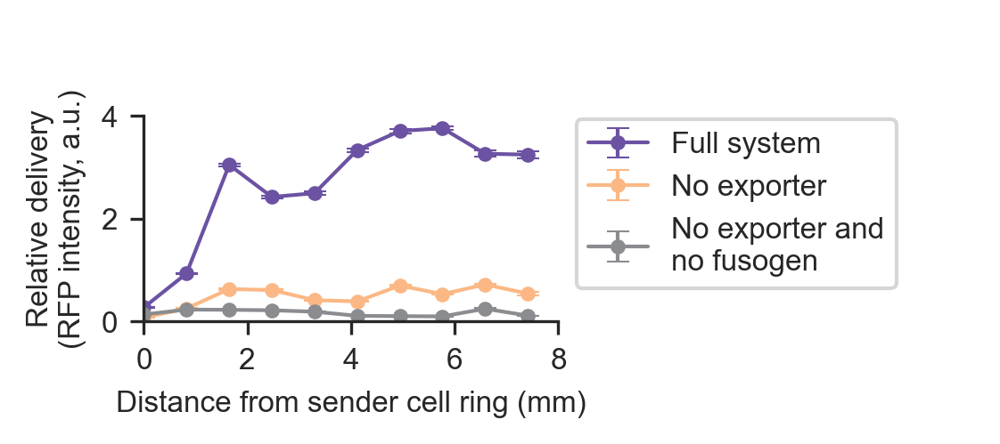

In [58]:
fig, ax = plt.subplots(1, 1, figsize=(2,1))

# Full system

selector = df_all["Condition"] == "FullSystem"
data_subset = df_all.loc[selector]

x = data_subset["d_sender_mean_mm"]
y = data_subset["intensity_bootstrap_mean"]
yerr = data_subset["intensity_bootstrap_std"]

ax.errorbar(x=x,
            y=y,
            yerr=yerr,
            marker=".",
            c=palette[0],
            capsize=3,
            capthick=0.5,
            lw=1,
            label="Full system")

# No exporter

selector = df_all["Condition"] == "NoExporter"
data_subset = df_all.loc[selector]

x = data_subset["d_sender_mean_mm"]
y = data_subset["intensity_bootstrap_mean"]
yerr = data_subset["intensity_bootstrap_std"]

ax.errorbar(x=x,
            y=y,
            yerr=yerr,
            marker=".",
            c=palette[1],
            capsize=3,
            capthick=0.5,
            lw=1,
            label="No exporter")

# No exporter

selector = df_all["Condition"] == "NoExporterNoFusogen"
data_subset = df_all.loc[selector]

x = data_subset["d_sender_mean_mm"]
y = data_subset["intensity_bootstrap_mean"]
yerr = data_subset["intensity_bootstrap_std"]

ax.errorbar(x=x,
            y=y,
            yerr=yerr,
            marker=".",
            c=palette[2],
            capsize=3,
            capthick=0.5,
            lw=1,
            label="No exporter and\nno fusogen")

ax.set_xlim(0, 8)
ax.set_ylim(0, 4)

ax.set_xlabel("Distance from sender cell ring (mm)")
ax.set_ylabel("Relative delivery\n(RFP intensity, a.u.)")

ax.set_xticks([0, 2, 4, 6, 8])

sns.despine()

fig.legend(loc="center left", bbox_to_anchor=(1.05, 0.9))

save_figure(fig, "delivery_vs_distance")